## OSM Roads

In [23]:
%matplotlib inline

In [24]:
from sqlalchemy import create_engine

import geopandas as gpd

In [25]:
import seaborn as sns

In [26]:
eng = create_engine("postgresql:///osm_quality")

In [27]:
SQLFILE = "../analyze-road.sql"

### Load Data

In [28]:
# Routes
with open(SQLFILE) as fobj:
    query = fobj.read()

In [29]:
data = gpd.read_postgis(query, eng)

In [30]:
data.head(10)

,osm_id,name,elem,version,n_user,n_autocorr,n_corr,first_at,last_at,last_uid,last_ug,geom
0,8637,Aquitaine,relation,579,82,353,225,2008-03-27,2018-12-17,211154,4,LINESTRING (0.3148775664339797 43.995359580159...
1,3792880,Nouvelle-Aquitaine,relation,131,44,50,80,2014-06-02,2018-12-17,211154,4,LINESTRING (-0.9931428999999998 45.57817380040...
2,1665392,Lesparre-Médoc,relation,15,8,4,10,2011-07-15,2017-11-04,1443767,4,LINESTRING (-0.7591208623898686 44.96371658163...
3,8637,Aquitaine,relation,579,82,353,225,2008-03-27,2018-12-17,211154,4,LINESTRING (-1.152305057310931 45.459106097482...
4,8637,Aquitaine,relation,579,82,353,225,2008-03-27,2018-12-17,211154,4,LINESTRING (-1.228175760484955 44.832617342733...
5,1667592,Langon,relation,31,15,10,20,2011-07-17,2016-12-05,339581,4,LINESTRING (-0.6823334999999999 44.45086860051...
6,3792880,Nouvelle-Aquitaine,relation,131,44,50,80,2014-06-02,2018-12-17,211154,4,LINESTRING (-0.6278656804922066 45.03624388795...
7,1665394,Blaye,relation,23,10,9,13,2011-07-15,2018-12-17,211154,4,LINESTRING (-0.7083086999999999 45.32746180043...
8,3792880,Nouvelle-Aquitaine,relation,131,44,50,80,2014-06-02,2018-12-17,211154,4,LINESTRING (-1.007320315947801 42.990004228849...
9,7376,Landes,relation,180,27,95,39,2008-03-15,2018-11-10,4224320,4,LINESTRING (-1.399204276770665 43.838669195806...


In [31]:
data.shape

(6787, 12)

In [32]:
# pas de support de sérialisation des dates en JSON
#data_to_write = data.copy()
#data_to_write["first_at"] = data_to_write["first_at"].apply(lambda x: x.isoformat())
#data_to_write["last_at"] = data_to_write["last_at"].apply(lambda x: x.isoformat())

#with open("geo-building.json", "w") as fobj:
#    fobj.write(data_to_write.to_json())

## Map

In [33]:
bordeaux_loc = [44.84042, -0.57001]  # proche du Node

In [34]:
import folium

In [35]:
geojson = data[["osm_id", "version", "last_ug", "geom"]].to_json()

In [36]:
geojson[:500]

'{"type": "FeatureCollection", "features": [{"id": "0", "type": "Feature", "properties": {"last_ug": 4, "osm_id": 8637, "version": 579}, "geometry": {"type": "LineString", "coordinates": [[0.31487756643397974, 43.99535958015943], [0.31478029999999996, 43.995398400532814], [0.31306419999999996, 43.99576630053281], [0.3128031, 43.99569850053282], [0.31270539999999997, 43.995602700532814], [0.31277669999999996, 43.99537820053282], [0.31331829999999994, 43.995076400532824], [0.3132823, 43.99457060053'

In [37]:
m = folium.Map(
    location=bordeaux_loc,
    # tiles='Mapbox Bright',
    tiles="cartodbpositron",
    zoom_start=11
)

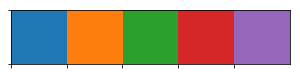

In [38]:
# choix de la palette "à la plotly / d3"
colors = ['#1f77b4',  # muted blue
          '#ff7f0e',  # safety orange
          '#2ca02c',  # cooked asparagus green
          '#d62728',  # brick red
          '#9467bd'  # muted purple
         ]
sns.palplot(colors)

In [39]:
# colors = sns.color_palette("Set2").as_hex()

def style_user(feature):
    user_group = feature["properties"]["last_ug"]
    return {
        "fillOpacity": 1.,
        "weight": 2,
        "fillColor": colors[user_group],
        "color": colors[user_group]
    }

In [40]:
folium.GeoJson(
    data[["osm_id", "last_ug", "geom"]],
    name='road',
    style_function=style_user
).add_to(m)

In [41]:
folium.LayerControl().add_to(m)
m

Groupe
  0      1      2      3      4


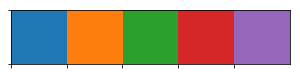

In [42]:
print("Groupe\n  " + "      ".join(str(x) for x in [0, 1, 2, 3, 4]))
sns.palplot(colors)